# **PHARMACEUTICALS SALES PREDICTION ACROSS MULTIPLE STORES**

## EXPLORATION ON CUSTOMER PURCHASING BEHAVIOURS

In [ ]:
#importing the libraries that will be needed in the program. A library is essentially a collection of modules that can be called and used.
import warnings
warnings.filterwarnings("ignore")
import numpy as np
import pandas as pd
from scipy import stats
import datetime 
import plotly.express as px
from tabulate import tabulate
import seaborn as sns
sns.set()
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn import preprocessing
import plotly.graph_objects as go

### Loading our dataset from kaggle using kaggle API

In [ ]:
# installing kaggle
!pip install --upgrade --force-reinstall --no-deps kaggle

Processing /root/.cache/pip/wheels/57/4e/e8/bb28d035162fb8f17f8ca5d42c3230e284c6aa565b42b72674/kaggle-1.5.6-cp36-none-any.whl
  Found existing installation: kaggle 1.5.6
    Uninstalling kaggle-1.5.6:
      Successfully uninstalled kaggle-1.5.6


In [ ]:
#importing kaggle API json file to our session
from google.colab import files

files.upload()

Saving kaggle.json to kaggle (1).json


{'kaggle.json': b'{"username":"davidoyogo","key":"9abfc4fba09288b24bd956a997584493"}'}

In [ ]:
! mkdir ~/.kaggle #making a directory named .kaggle

! cp kaggle.json ~/.kaggle/ # Copying the kaggle json file to the .kaggle directory

mkdir: cannot create directory ‘/root/.kaggle’: File exists


In [ ]:
#Changing the permissions of the file.
! chmod 600 ~/.kaggle/kaggle.json

In [ ]:
#One can see the kaggle datasets 
! kaggle datasets list

ref                                                               title                                              size  lastUpdated          downloadCount  voteCount  usabilityRating  
----------------------------------------------------------------  ------------------------------------------------  -----  -------------------  -------------  ---------  ---------------  
Cornell-University/arxiv                                          arXiv Dataset                                     877MB  2020-08-14 23:50:57           1569        378  0.875            
agirlcoding/all-space-missions-from-1957                          All Space Missions from 1957                      101KB  2020-08-13 16:18:58            319         54  0.85294116       
landlord/handwriting-recognition                                  Handwriting Recognition                             1GB  2020-08-05 17:20:36             87         24  0.9411765        
jmmvutu/summer-products-and-sales-in-ecommerce-wish         

In [ ]:
#Downloading the kaggle datasets by passing the name of the competition
! kaggle competitions download -c 'rossmann-store-sales'

rossmann-store-sales.zip: Skipping, found more recently modified local copy (use --force to force download)


In [ ]:
#Making a directory named rossman
! mkdir rossman

mkdir: cannot create directory ‘rossman’: File exists


In [ ]:
#Unzipping the data
! unzip rossmann-store-sales.zip -d rossman/

Archive:  rossmann-store-sales.zip
replace rossman/sample_submission.csv? [y]es, [n]o, [A]ll, [N]one, [r]ename: n
replace rossman/store.csv? [y]es, [n]o, [A]ll, [N]one, [r]ename: n
replace rossman/test.csv? [y]es, [n]o, [A]ll, [N]one, [r]ename: n
replace rossman/train.csv? [y]es, [n]o, [A]ll, [N]one, [r]ename: n


In [ ]:
#Loading the downloaded dataset
store_data=pd.read_csv('/content/rossman/store.csv')
train_data=pd.read_csv('/content/rossman/train.csv')
test_data=pd.read_csv('/content/rossman/test.csv')

In [ ]:
#Viewing five rows of store data
store_data

,Store,StoreType,Assortment,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,PromoInterval
0,1,c,a,1270.0,9.0,2008.0,0,NaN,NaN,NaN
1,2,a,a,570.0,11.0,2007.0,1,13.0,2010.0,"Jan,Apr,Jul,Oct"
2,3,a,a,14130.0,12.0,2006.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
3,4,c,c,620.0,9.0,2009.0,0,NaN,NaN,NaN
4,5,a,a,29910.0,4.0,2015.0,0,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
1110,1111,a,a,1900.0,6.0,2014.0,1,31.0,2013.0,"Jan,Apr,Jul,Oct"
1111,1112,c,c,1880.0,4.0,2006.0,0,NaN,NaN,NaN
1112,1113,a,c,9260.0,NaN,NaN,0,NaN,NaN,NaN
1113,1114,a,c,870.0,NaN,NaN,0,NaN,NaN,NaN


In [ ]:
#Viewing five rows of train data
train_data

,Store,DayOfWeek,Date,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday
0,1,5,2015-07-31,5263,555,1,1,0,1
1,2,5,2015-07-31,6064,625,1,1,0,1
2,3,5,2015-07-31,8314,821,1,1,0,1
3,4,5,2015-07-31,13995,1498,1,1,0,1
4,5,5,2015-07-31,4822,559,1,1,0,1
...,...,...,...,...,...,...,...,...,...
1017204,1111,2,2013-01-01,0,0,0,0,a,1
1017205,1112,2,2013-01-01,0,0,0,0,a,1
1017206,1113,2,2013-01-01,0,0,0,0,a,1
1017207,1114,2,2013-01-01,0,0,0,0,a,1


In [ ]:
#Viewing five rows of test data
test_data

,Id,Store,DayOfWeek,Date,Open,Promo,StateHoliday,SchoolHoliday
0,1,1,4,2015-09-17,1.0,1,0,0
1,2,3,4,2015-09-17,1.0,1,0,0
2,3,7,4,2015-09-17,1.0,1,0,0
3,4,8,4,2015-09-17,1.0,1,0,0
4,5,9,4,2015-09-17,1.0,1,0,0
...,...,...,...,...,...,...,...,...
41083,41084,1111,6,2015-08-01,1.0,0,0,0
41084,41085,1112,6,2015-08-01,1.0,0,0,0
41085,41086,1113,6,2015-08-01,1.0,0,0,0
41086,41087,1114,6,2015-08-01,1.0,0,0,0


**Short description:**
* Sales: the turnover for any given day (target variable).
* Customers: the number of customers on a given day.
* Open: an indicator for whether the store was open: 0 = closed, 1 = open.
* Promo: indicates whether a store is running a promo on that day.
* StateHoliday: indicates a state holiday. Normally all stores, with few exceptions, are closed on state holidays.
* SchoolHoliday: indicates if the (Store, Date) was affected by the closure of public schools.
* Store: a unique Id for each store
* StoreType: differentiates between 4 different store models: a, b, c, d
* Assortment: describes an assortment level: a = basic, b = extra, c = extended
* CompetitionDistance: distance in meters to the nearest competitor store
8 CompetitionOpenSince[Month/Year]: gives the approximate year and month of the time the nearest competitor was opened
* Promo2: Promo2 is a continuing a promotion for some stores: 0 = store is not participating, 1 = store is participating
* Promo2Since[Year/Week]: describes the year and calendar week when the store started participating in Promo2
* PromoInterval: describes the consecutive intervals Promo2 is started, naming the months the promotion is started. E.g. "Feb,May,Aug,Nov" means each round starts in February, May, August, November of any given year for that store

## **Data preprocessing**

###Numerical, Categorical and TimeStamp features

In [ ]:
numerical = []
categorical = []
timestamps = []

for col in train_data.columns:
    if train_data[col].dtype in ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']:
        numerical.append(col)
    elif train_data[col].dtype == object:
        categorical.append(col)
    else:
        timestamps.append(col)
        
        
features = numerical+categorical+timestamps
train_data = train_data[features]
train_data

,Store,DayOfWeek,Sales,Customers,Open,Promo,SchoolHoliday,Date,StateHoliday
0,1,5,5263,555,1,1,1,2015-07-31,0
1,2,5,6064,625,1,1,1,2015-07-31,0
2,3,5,8314,821,1,1,1,2015-07-31,0
3,4,5,13995,1498,1,1,1,2015-07-31,0
4,5,5,4822,559,1,1,1,2015-07-31,0
...,...,...,...,...,...,...,...,...,...
1017204,1111,2,0,0,0,0,1,2013-01-01,a
1017205,1112,2,0,0,0,0,1,2013-01-01,a
1017206,1113,2,0,0,0,0,1,2013-01-01,a
1017207,1114,2,0,0,0,0,1,2013-01-01,a


In [ ]:
# change the date col to a timestamp feature
train_data.date = pd.to_datetime(train_data["Date"])


In [ ]:
numerical = []
categorical = []
timestamps = []

for col in test_data.columns:
    if test_data[col].dtype in ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']:
        numerical.append(col)
    elif test_data[col].dtype == object:
        categorical.append(col)
    else:
        timestamps.append(col)
        
        
features = numerical+categorical+timestamps
test_data = test_data[features]
test_data.head(3)

,Id,Store,DayOfWeek,Open,Promo,SchoolHoliday,Date,StateHoliday
0,1,1,4,1.0,1,0,2015-09-17,0
1,2,3,4,1.0,1,0,2015-09-17,0
2,3,7,4,1.0,1,0,2015-09-17,0


In [ ]:
# change the date col to a timestamp feature
test_data.date = pd.to_datetime(test_data["Date"])

In [ ]:
numerical = []
categorical = []
timestamps = []

for col in store_data.columns:
    if store_data[col].dtype in ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']:
        numerical.append(col)
    elif store_data[col].dtype == object:
        categorical.append(col)
    else:
        timestamps.append(col)
        
        
features = numerical+categorical+timestamps
store_data = store_data[features]
store_data.head(3)

,Store,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,StoreType,Assortment,PromoInterval
0,1,1270.0,9.0,2008.0,0,NaN,NaN,c,a,NaN
1,2,570.0,11.0,2007.0,1,13.0,2010.0,a,a,"Jan,Apr,Jul,Oct"
2,3,14130.0,12.0,2006.0,1,14.0,2011.0,a,a,"Jan,Apr,Jul,Oct"


In [ ]:
#Knowing the shapes of our datasets
print('Shapes of our datasets')
print('-----------------------')
print(f'Training dataset:{train_data.shape}')
print(f'Testing dataset:{test_data.shape}')
print(f'Store dataset:{store_data.shape}')

Shapes of our datasets
-----------------------
Training dataset:(1017209, 9)
Testing dataset:(41088, 8)
Store dataset:(1115, 10)


In [ ]:
#Encoding some of the columns 
  
# label_encoder object knows how to understand word labels. 
label_encoder = preprocessing.LabelEncoder() 
  
# Encode labels in column 'StoreType'. 
store_data['StoreType']= label_encoder.fit_transform(store_data['StoreType']) 

In [ ]:
# Encode labels in column 'Assortment'. 
store_data['Assortment']= label_encoder.fit_transform(store_data['Assortment'])

**Replacing values to deal with Cardinality**

In [ ]:
## Dealing with cardinality
train_data['StateHoliday'].replace({0:'o','0':'o'},inplace=True)
test_data['StateHoliday'].replace({'0':'o'},inplace=True)

## **Data cleaning process**

The data cleaning process involves building pipelines to detect and handle outlier and missing data. This is particularly important because we don’t want to skew our analysis.

In [ ]:
#checking for number of entries
train_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1017209 entries, 0 to 1017208
Data columns (total 9 columns):
 #   Column         Non-Null Count    Dtype 
---  ------         --------------    ----- 
 0   Store          1017209 non-null  int64 
 1   DayOfWeek      1017209 non-null  int64 
 2   Sales          1017209 non-null  int64 
 3   Customers      1017209 non-null  int64 
 4   Open           1017209 non-null  int64 
 5   Promo          1017209 non-null  int64 
 6   SchoolHoliday  1017209 non-null  int64 
 7   Date           1017209 non-null  object
 8   StateHoliday   1017209 non-null  object
dtypes: int64(7), object(2)
memory usage: 69.8+ MB


In [ ]:
#checking for number of entries
test_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41088 entries, 0 to 41087
Data columns (total 8 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             41088 non-null  int64  
 1   Store          41088 non-null  int64  
 2   DayOfWeek      41088 non-null  int64  
 3   Open           41077 non-null  float64
 4   Promo          41088 non-null  int64  
 5   SchoolHoliday  41088 non-null  int64  
 6   Date           41088 non-null  object 
 7   StateHoliday   41088 non-null  object 
dtypes: float64(1), int64(5), object(2)
memory usage: 2.5+ MB


In [ ]:
#checking for number of entries
store_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1115 entries, 0 to 1114
Data columns (total 10 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Store                      1115 non-null   int64  
 1   CompetitionDistance        1112 non-null   float64
 2   CompetitionOpenSinceMonth  761 non-null    float64
 3   CompetitionOpenSinceYear   761 non-null    float64
 4   Promo2                     1115 non-null   int64  
 5   Promo2SinceWeek            571 non-null    float64
 6   Promo2SinceYear            571 non-null    float64
 7   StoreType                  1115 non-null   int64  
 8   Assortment                 1115 non-null   int64  
 9   PromoInterval              571 non-null    object 
dtypes: float64(5), int64(4), object(1)
memory usage: 87.2+ KB


In [ ]:
#checking for sum of nulls values
print('Sum of null values in training dataset')
print('--------------------------------------')
print(train_data.isna().sum())
print('Sum of null values in testing dataset')
print('--------------------------------------')
print(test_data.isna().sum())
print('Sum of null values store dataset')
print('--------------------------------------')
print(store_data.isna().sum())

Sum of null values in training dataset
--------------------------------------
Store            0
DayOfWeek        0
Sales            0
Customers        0
Open             0
Promo            0
SchoolHoliday    0
Date             0
StateHoliday     0
dtype: int64
Sum of null values in testing dataset
--------------------------------------
Id                0
Store             0
DayOfWeek         0
Open             11
Promo             0
SchoolHoliday     0
Date              0
StateHoliday      0
dtype: int64
Sum of null values store dataset
--------------------------------------
Store                          0
CompetitionDistance            3
CompetitionOpenSinceMonth    354
CompetitionOpenSinceYear     354
Promo2                         0
Promo2SinceWeek              544
Promo2SinceYear              544
StoreType                      0
Assortment                     0
PromoInterval                544
dtype: int64


From the above results, we see presence of null values in testing dataset and store dataset. They should be handled plus outliers

**1. Training Data**

1. Handling missing values

In [ ]:

#Function for etecting outliers in our numerical variables data using boxplots
def plot_outliers(dataFrame, vars_names):    
    fig, ax = plt.subplots(len(vars_names), figsize = (7, 20))
    
    for i, var in enumerate(vars_names):
        sns.boxplot(y = dataFrame[var], ax = ax[i])
        ax[i].set_title('Box plot - {}'.format(var), fontsize = 10)
        ax[i].set_xlabel(var, fontsize = 8)

    plt.show()
  

  # a function for replacing outliers with the median, used when there's too many outliers in a feature
def replace_outlier_with_median(dataFrame, feature):
    Q1 = dataFrame[feature].quantile(0.25)
    Q3 = dataFrame[feature].quantile(0.75)
    median = dataFrame[feature].quantile(0.50)

    IQR = Q3 - Q1

    upper_whisker = Q3 + (1.5 * IQR)
    lower_whisker = Q1 - (1.5 * IQR)

    dataFrame[feature] = np.where(dataFrame[feature] > upper_whisker, median, dataFrame[feature])
    dataFrame[feature] = np.where(dataFrame[feature] < lower_whisker, median, dataFrame[feature])

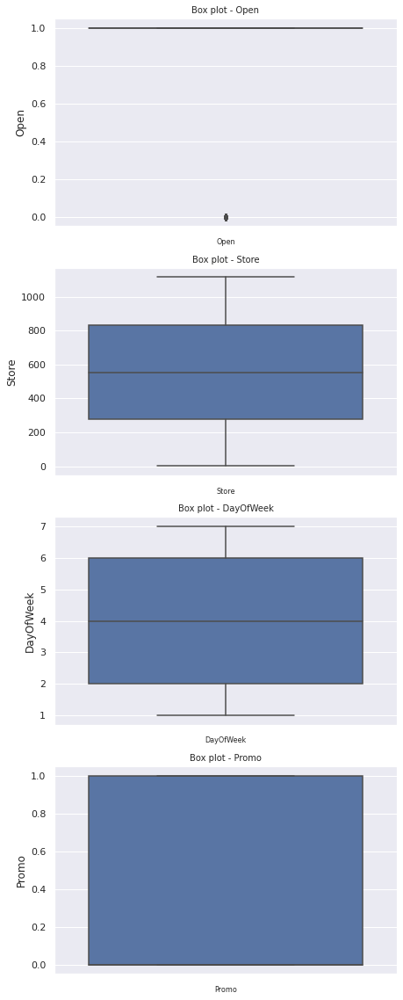

In [ ]:
plot_outliers(test_data, ['Open', 'Store','DayOfWeek','Promo'])

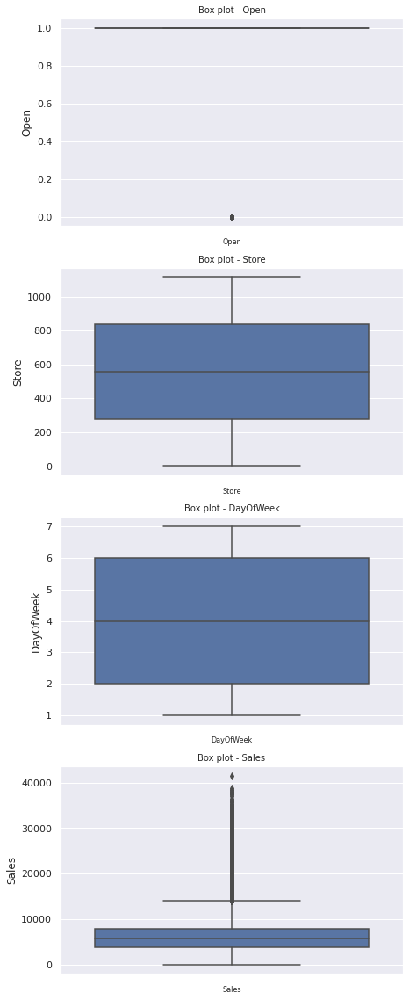

In [ ]:
plot_outliers(train_data, ['Open', 'Store','DayOfWeek','Sales'])

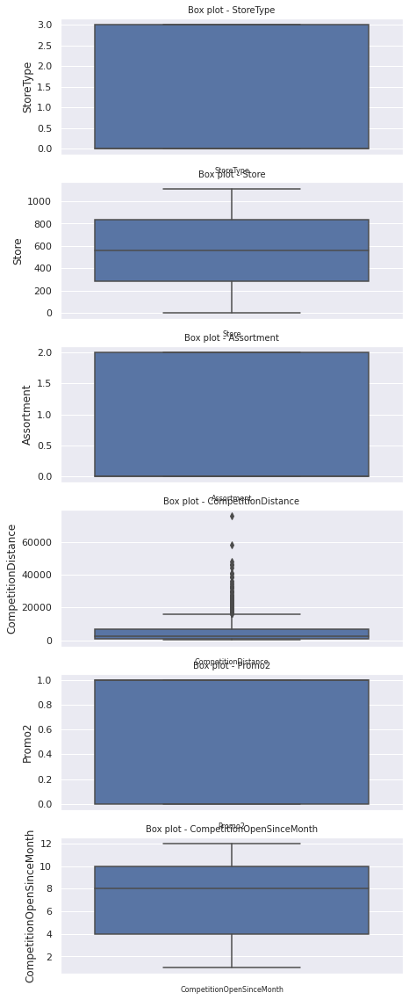

In [ ]:

plot_outliers(store_data, ['StoreType', 'Store','Assortment','CompetitionDistance','Promo2','CompetitionOpenSinceMonth'])




Below we will take a deep dive into the sales and customers in the training set.

**1. Sales**

In [ ]:
train_data.Sales.describe() 
#we see here a minimum of 0 which means some stores even opened got 0 sales on some days

count    1.017209e+06
mean     5.773819e+03
std      3.849926e+03
min      0.000000e+00
25%      3.727000e+03
50%      5.744000e+03
75%      7.856000e+03
max      4.155100e+04
Name: Sales, dtype: float64

In [ ]:
train_data=train_data.drop(train_data[(train_data.Open == 1) & (train_data.Sales == 0)].index)
train_data = train_data.reset_index(drop=True)

{'Mean': 5774.125500046699, 'Median': 5744.0}

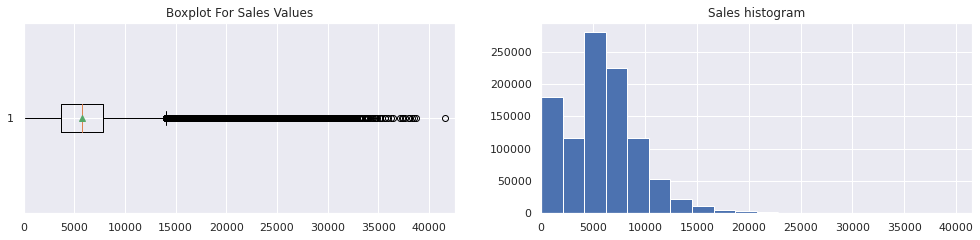

In [ ]:
fig, axes = plt.subplots(1, 2, figsize=(17,3.5))
axes[0].boxplot(train_data.Sales, showmeans=True,vert=False)
axes[0].set_xlim(0,max(train_data["Sales"]+1000))
axes[0].set_title('Boxplot For Sales Values')
axes[1].hist(train_data.Sales, cumulative=False, bins=20)
axes[1].set_title("Sales histogram")
axes[1].set_xlim((min(train_data.Sales), max(train_data.Sales)))

{"Mean":np.mean(train_data.Sales),"Median":np.median(train_data.Sales)}

* Some exceptions (the outliers) in the boxplot had to be checked to see if it's wrong inputted data but it turns out this big amount of sales on certain days is explained by either promotional purposes,the type of the store being big and popular or just not having near enough competition and being the monopoly in its region. 

* Concerning the 0 of the time having 0 sales.it represented before removing them a tiny amount of the train set(0.01%), those values can affect further calculation of metrics and bias and are not to be taken into account. Those cases could happen for some shops, probably due to external events affecting it.

* An important metric to always check when looking at a distribution is how the mean compares to the median and how close are they from each other. As we see here a mean of 5473 versus 5744 in median is a very good sign that there are no extravagant values affecting the general distribution of Sales.

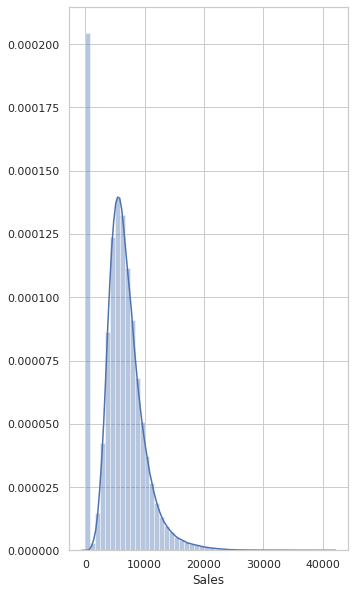

In [ ]:
#Find the range of data
plt.figure(figsize=(5,10))
sns.set(style="whitegrid")
sns.distplot(train_data["Sales"])

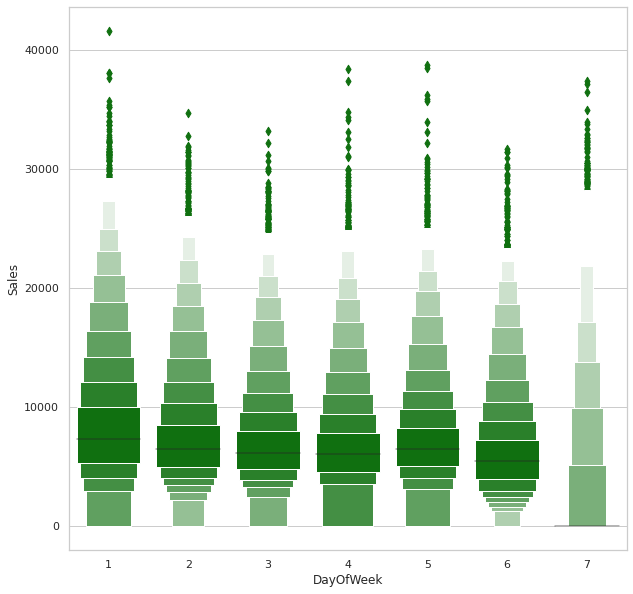

In [ ]:
plt.figure(figsize=(10,10))
sns.set(style="whitegrid")
sns.boxenplot(data=train_data,scale="linear",x="DayOfWeek",y="Sales",color="Green")

**2. Customers**

In [ ]:
train_data.Customers.describe() 

count    1.017155e+06
mean     6.331796e+02
std      4.644012e+02
min      0.000000e+00
25%      4.050000e+02
50%      6.090000e+02
75%      8.370000e+02
max      7.388000e+03
Name: Customers, dtype: float64

{'Mean': 633.1795517890587, 'Median': 609.0}

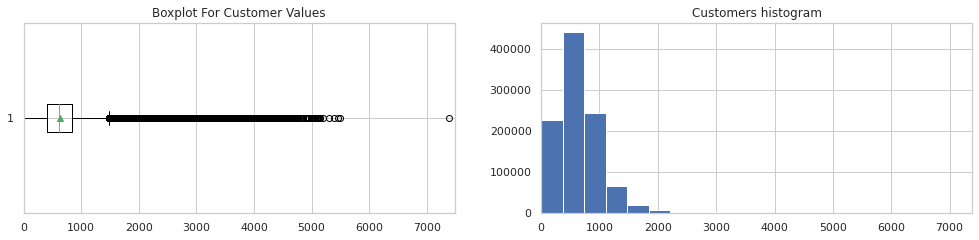

In [ ]:
fig, axes = plt.subplots(1, 2, figsize=(17,3.5))
axes[0].boxplot(train_data.Customers, showmeans=True,vert=False)
axes[0].set_xlim(0,max(train_data["Customers"]+100))
axes[0].set_title('Boxplot For Customer Values')
axes[1].hist(train_data.Customers, cumulative=False, bins=20)
axes[1].set_title("Customers histogram")
axes[1].set_xlim((min(train_data.Customers), max(train_data.Customers)))

{"Mean":np.mean(train_data.Customers),"Median":np.median(train_data.Customers)}

In [ ]:
stats.pearsonr(train_data.Customers, train_data.Sales)[0]

0.8946997899355651

* We can see similair patterns with the customers column and the Sales column, in fact our pearson correlation factor of 0.75 explains that there is a strong positive correlation between Sales and Customers. In general, the more customers you have in a store, the higher your sales for the day.

* We see that on a specific day there was a huge amount of customers in a store,this was due to a big promotion going on. Those specific values are affecting the mean which concludes the difference between a mean of 633 and a median of 609.

* We observe a right skewness in both distributions because of the low number of outliers but the high representation of each outlier alone which pushes the distribution to the lefta as seen in both histograms.This typically occurs when the mean is higher than the median.

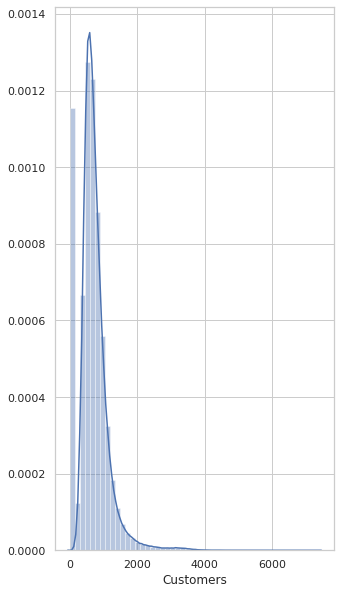

In [ ]:
#Find the range of the data
plt.figure(figsize=(5,10))
sns.set(style="whitegrid")
sns.distplot(train_data["Customers"])

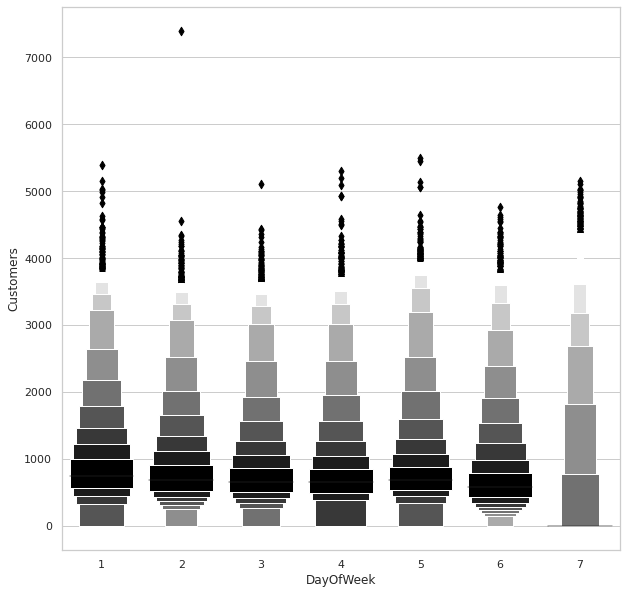

In [ ]:
plt.figure(figsize=(10,10))
sns.set(style="whitegrid")
sns.boxenplot(y="Customers", x="DayOfWeek",data=train_data, scale="linear",color="Black")

This data, contains many outliers, but these might have been caused to the surge of customers during a festival or Holiday, or due to an effective promo

**2. Store Data**

*A closer look at the Store Dataset:*

In [ ]:
store_data.count(0)/store_data.shape[0] * 100

Store                        100.000000
CompetitionDistance           99.730942
CompetitionOpenSinceMonth     68.251121
CompetitionOpenSinceYear      68.251121
Promo2                       100.000000
Promo2SinceWeek               51.210762
Promo2SinceYear               51.210762
StoreType                    100.000000
Assortment                   100.000000
PromoInterval                 51.210762
dtype: float64

* The Promo2SinceWeek,Promo2SinceYear and PromoInterval variables has 51% fill rate since they are actually NULL values because there are no continuous promotion for those stores.

* Instead for CompetitionOpenSinceMonth and CompetitionOpenSinceYear, it's basically missing data that we're dealing with here (68.25% fill rate), this means that we have the nearest distance of the competitor but miss the date information on when did he actually opened next to the Rossman store.

**1) CompetitionDistance:**

* Before deciding how to treat this,we know there are infinite ways of filling missing values.
* The most common and simplistic approach is to fill it with either the mean or the median of this variable.
* Let's quickly have a look at those metrics.

{'Mean': 5404.901079136691,
 'Median': 2325.0,
 'Standard Dev': 7659.7282732764415}

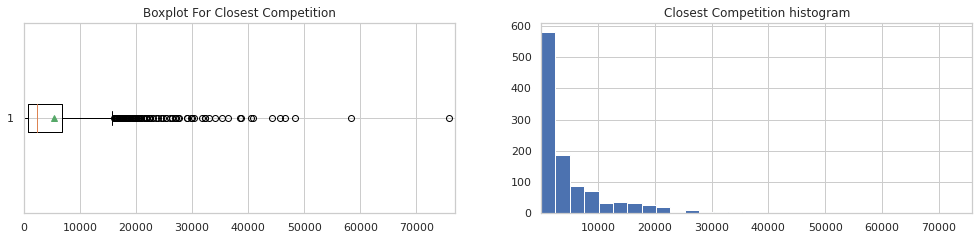

In [ ]:
df_store_check_distribution=store_data.drop(store_data[pd.isnull(store_data.CompetitionDistance)].index)
fig, axes = plt.subplots(1, 2, figsize=(17,3.5))
axes[0].boxplot(df_store_check_distribution.CompetitionDistance, showmeans=True,vert=False,)
axes[0].set_xlim(0,max(df_store_check_distribution.CompetitionDistance+1000))
axes[0].set_title('Boxplot For Closest Competition')
axes[1].hist(df_store_check_distribution.CompetitionDistance, cumulative=False, bins=30)
axes[1].set_title("Closest Competition histogram")
axes[1].set_xlim((min(df_store_check_distribution.CompetitionDistance), max(df_store_check_distribution.CompetitionDistance)))
{"Mean":np.nanmean(store_data.CompetitionDistance),"Median":np.nanmedian(store_data.CompetitionDistance),"Standard Dev":np.nanstd(store_data.CompetitionDistance)}#That's what i thought, very different values, let's see why 

We see a highly right skewed distribution for this variable with a significant difference between the mean and the median. This being caused by the amount of disperness in the data with a standard deviation of 3583, higher than the mean and the median.

**What do we Do then:**

It is realistically better to input the median value to the three Nan stores then the mean since the mean is biased by those outliers

In [ ]:
store_data['CompetitionDistance'].fillna(store_data['CompetitionDistance'].median(), inplace = True)

**2) CompetitionOpenSinceMonth and CompetitionOpenSinceYear?**

* Since we have no information whatsoever on those missing values and no accurate way of filling those values.
* A creative way could be to apply a multilabel classification algorithm and train on the non Nan fields and then predict what could be most probably the month and year for those fields. But this approach is computationally too long.
* So for this purpose those fields are going to be assigned to 0 .

In [ ]:
store_data.CompetitionOpenSinceMonth.fillna(0, inplace = True)
store_data.CompetitionOpenSinceYear.fillna(0,inplace=True)

**3) Promo2SinceWeek, Promo2SinceYear and PromoInterval ?**

* This case is pretty straighforward, all the missing values comes from fields where Promo2=0 which means there are no continuous promotional activities for those stores.
* Having no promotion means those fields have to be 0 as well since they are linked to Promo2.

In [ ]:
store_data.Promo2SinceWeek.fillna(0,inplace=True)
store_data.Promo2SinceYear.fillna(0,inplace=True)
store_data.PromoInterval.fillna(0,inplace=True)

In [ ]:
store_data.count(0)/store_data.shape[0] * 100

Store                        100.0
CompetitionDistance          100.0
CompetitionOpenSinceMonth    100.0
CompetitionOpenSinceYear     100.0
Promo2                       100.0
Promo2SinceWeek              100.0
Promo2SinceYear              100.0
StoreType                    100.0
Assortment                   100.0
PromoInterval                100.0
dtype: float64

Now all the null values are taken care of

### **Merging the Datasets**

In this section we merge the store data with the training dataset and the testing set because the store data contains moew features which count in our analysis

In [ ]:
#Merging the training dataset with the store dataset 
train_store_data=pd.merge(train_data, store_data, on='Store', how='inner')

In [ ]:
#Merging the test dataset with the store dataset
test_store_data=pd.merge(test_data, store_data, on='Store', how='inner')

# **Exploratory Data Analysis**




1. Seasonality Check between the training set and Testing set

We are dealing with time series data so it will probably serve us to extract dates for further analysis.


In [ ]:
train_store_data

,Store,DayOfWeek,Sales,Customers,Open,Promo,SchoolHoliday,Date,StateHoliday,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,StoreType,Assortment,PromoInterval
0,1,5,5263,555,1,1,1,2015-07-31,o,1270.0,9.0,2008.0,0,0.0,0.0,2,0,0
1,1,4,5020,546,1,1,1,2015-07-30,o,1270.0,9.0,2008.0,0,0.0,0.0,2,0,0
2,1,3,4782,523,1,1,1,2015-07-29,o,1270.0,9.0,2008.0,0,0.0,0.0,2,0,0
3,1,2,5011,560,1,1,1,2015-07-28,o,1270.0,9.0,2008.0,0,0.0,0.0,2,0,0
4,1,1,6102,612,1,1,1,2015-07-27,o,1270.0,9.0,2008.0,0,0.0,0.0,2,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1017150,1115,6,4771,339,1,0,1,2013-01-05,o,5350.0,0.0,0.0,1,22.0,2012.0,3,2,"Mar,Jun,Sept,Dec"
1017151,1115,5,4540,326,1,0,1,2013-01-04,o,5350.0,0.0,0.0,1,22.0,2012.0,3,2,"Mar,Jun,Sept,Dec"
1017152,1115,4,4297,300,1,0,1,2013-01-03,o,5350.0,0.0,0.0,1,22.0,2012.0,3,2,"Mar,Jun,Sept,Dec"
1017153,1115,3,3697,305,1,0,1,2013-01-02,o,5350.0,0.0,0.0,1,22.0,2012.0,3,2,"Mar,Jun,Sept,Dec"


In [ ]:
# data extraction

train_store_data["Date"]=pd.to_datetime(train_store_data["Date"])
train_store_data['Year']=train_store_data.Date.dt.year
train_store_data['Month']=train_store_data.Date.dt.month
train_store_data['Day']=train_store_data.Date.dt.day

# adding new variable
train_store_data['SalePerCustomer'] = train_store_data['Sales']/train_store_data['Customers']
train_store_data['SalePerCustomer'].describe()

count    844338.000000
mean          9.493641
std           2.197448
min           2.749075
25%           7.895571
50%           9.250000
75%          10.899729
max          64.957854
Name: SalePerCustomer, dtype: float64

On average customers spend about 9.50$ per day. Though there are days with Sales equal to zero.

In [ ]:
train_store_data

In [ ]:
time_series = train_data[['Date','Sales']]

In [ ]:
time_series['datetime'] = pd.to_datetime(time_series['Date'])
time_series = time_series.set_index('datetime')
time_series.drop(['Date'], axis=1, inplace=True)
time_series.head()

,Sales
datetime,
2015-07-31,5263
2015-07-31,6064
2015-07-31,8314
2015-07-31,13995
2015-07-31,4822


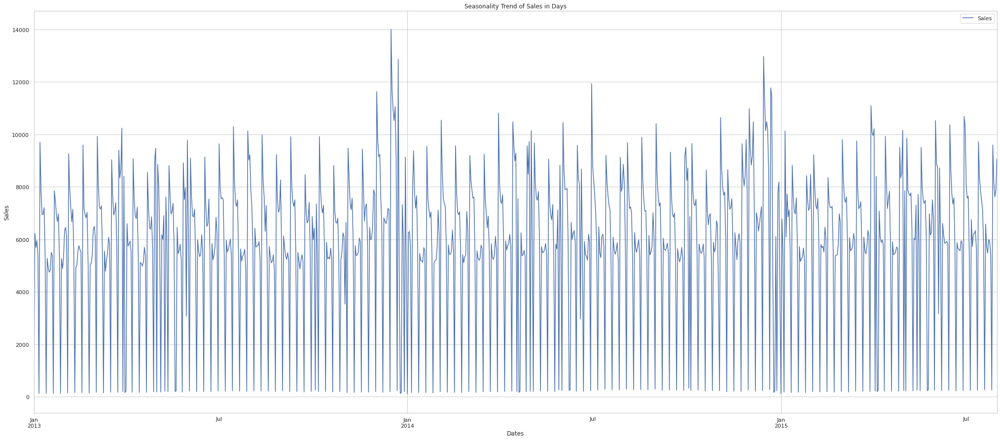

In [ ]:
time_series_day = time_series.resample('D').mean()
time_series_day.plot(figsize=(35,15))
plt.xlabel('Dates')
plt.ylabel('Sales')
plt.title('Seasonality Trend of Sales in Days')
plt.show()

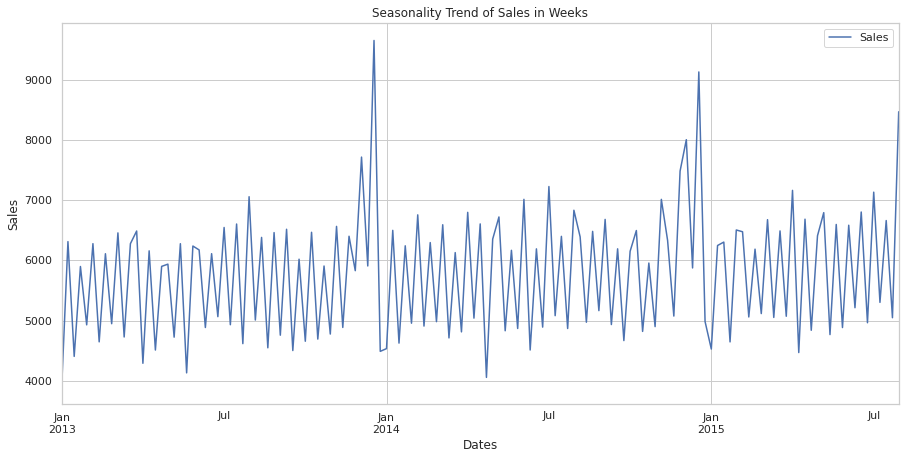

In [ ]:
time_series_week = time_series.resample('W').mean()
time_series_week.plot(figsize=(15,7))
plt.xlabel('Dates')
plt.ylabel('Sales')
plt.title('Seasonality Trend of Sales in Weeks')
plt.show()

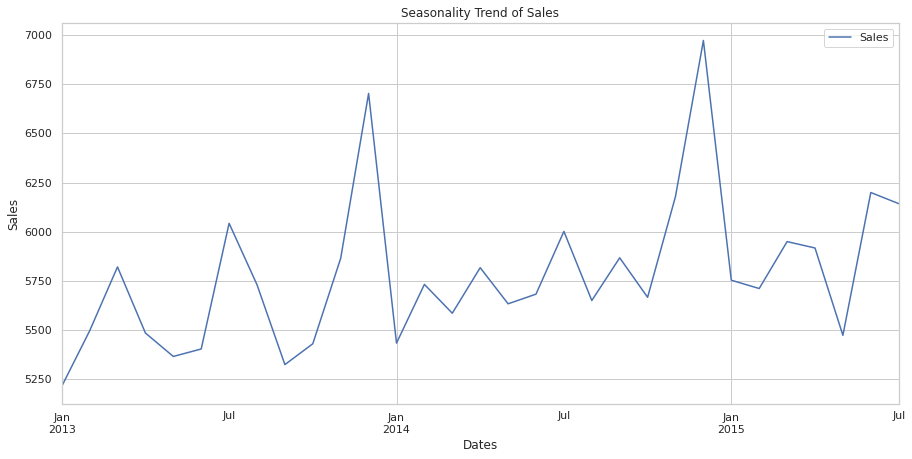

In [ ]:
time_series_month = time_series.resample('M').mean()
time_series_month.plot(figsize=(15,7))
plt.xlabel('Dates')
plt.ylabel('Sales')
plt.title('Seasonality Trend of Sales')

plt.show()

In [ ]:
season_data = train_data.groupby(['StateHoliday']).agg({'StateHoliday': ['count']})
season_data.columns = ['count']
season_data = season_data.reset_index()
print(tabulate(season_data.head(), headers = 'keys', tablefmt = 'fancy_grid'))

╒════╤════════════════╤═════════╕
│    │ StateHoliday   │   count │
╞════╪════════════════╪═════════╡
│  0 │ a              │   20260 │
├────┼────────────────┼─────────┤
│  1 │ b              │    6690 │
├────┼────────────────┼─────────┤
│  2 │ c              │    4100 │
├────┼────────────────┼─────────┤
│  3 │ o              │  986105 │
╘════╧════════════════╧═════════╛


In [ ]:
fig = px.bar(season_data, x='StateHoliday', y='count',
             labels={'count':'number of holidays or no holidays'}, height=400)
fig.show()

In [ ]:
season_data1 = test_data.groupby(['StateHoliday']).agg({'StateHoliday': ['count']})
season_data1.columns = ['count']
season_data1 = season_data1.reset_index()
print(tabulate(season_data1.head(), headers = 'keys', tablefmt = 'fancy_grid'))

╒════╤════════════════╤═════════╕
│    │ StateHoliday   │   count │
╞════╪════════════════╪═════════╡
│  0 │ a              │     180 │
├────┼────────────────┼─────────┤
│  1 │ o              │   40908 │
╘════╧════════════════╧═════════╛


In [ ]:
fig = px.bar(season_data1, x='StateHoliday', y='count',
             labels={'count':'number of holidays or no holidays'}, height=400)
fig.show()

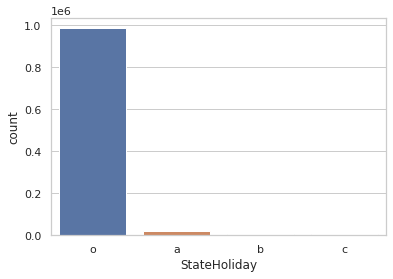

In [ ]:
# StateHoliday

# StateHoliday column has values 0 & "0", So, we need to merge values with 0 to "0"
train_data["StateHoliday"].loc[train_data["StateHoliday"] == 0] = "0"
test_data["StateHoliday"].loc[test_data["StateHoliday"] == 0] = "0"

#plots to compare state of holiday between the two sets
sns.countplot(x="StateHoliday", data=train_data)



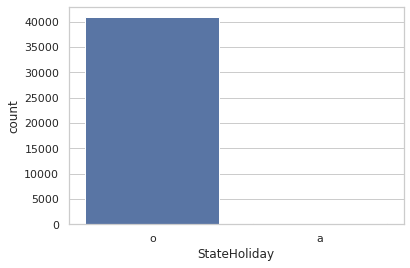

In [ ]:
sns.countplot(x="StateHoliday", data=test_data)

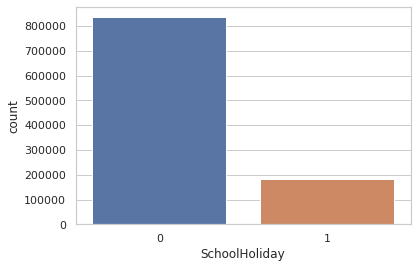

In [ ]:
# SchoolHoliday

# Plot
sns.countplot(x='SchoolHoliday', data=train_data)

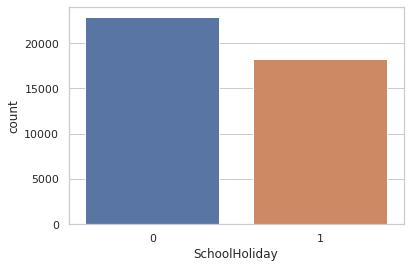

In [ ]:
# SchoolHoliday

# Plot
sns.countplot(x='SchoolHoliday', data=test_data)

2. Sales behavior before, during and after holidays

[Text(0.5, 1.0, 'Barplot showing Sales Distribution in StateHolidays')]

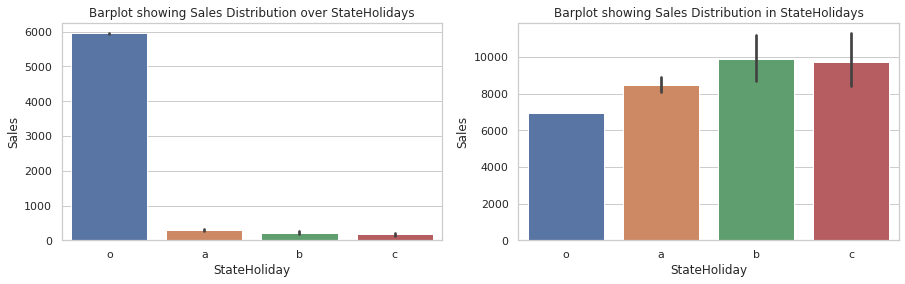

In [ ]:
#StateHoliday
# Before
fig, (axis1,axis2) = plt.subplots(1,2,figsize=(15,4))

sns.barplot(x='StateHoliday', y='Sales', data=train_data, ax=axis1).set(title='Barplot showing Sales Distribution over StateHolidays')
#During the season
mask = (train_data["StateHoliday"] != "0") & (train_data["Sales"] > 0)
sns.barplot(x='StateHoliday', y='Sales', data=train_data[mask], ax=axis2).set(title='Barplot showing Sales Distribution in StateHolidays')

[Text(0.5, 1.0, 'Barplot showing Sales Distribution over StateHolidays')]

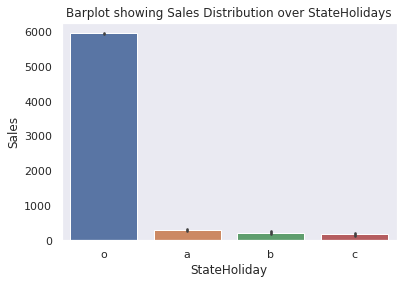

In [ ]:
# After
sns.set_style("dark")
sns.barplot(x='StateHoliday', y='Sales', data=train_data).set(title='Barplot showing Sales Distribution over StateHolidays')

3. Seasonal Purchases Behaviour

In [ ]:
# Create Year and Month columns
train_data['Year']  = train_data['Date'].apply(lambda x: int(str(x)[:4]))
train_data['Month'] = train_data['Date'].apply(lambda x: int(str(x)[5:7]))

test_data['Year']  = test_data['Date'].apply(lambda x: int(str(x)[:4]))
test_data['Month'] = test_data['Date'].apply(lambda x: int(str(x)[5:7]))

# Assign Date column to Date(Year-Month) instead of (Year-Month-Day)
# this column will be useful in analysis and visualization
train_data['Date'] = train_data['Date'].apply(lambda x: (str(x)[:7]))
test_data['Date']     = test_data['Date'].apply(lambda x: (str(x)[:7]))

In [ ]:
average_sales    = train_data.groupby('StateHoliday')["Sales"].mean()

[Text(0, 0, 'a'), Text(0, 0, 'b'), Text(0, 0, 'c'), Text(0, 0, 'o')]

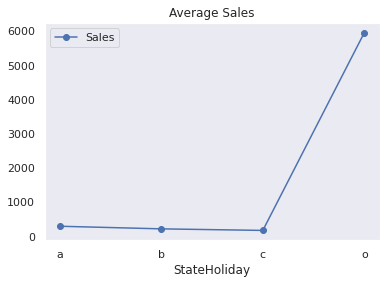

In [ ]:
ax1 = average_sales.plot(legend=True,marker='o',title="Average Sales")
ax1.set_xticks(range(len(average_sales)))
ax1.set_xticklabels(average_sales.index.tolist())



In [ ]:
table = pd.pivot_table(data=train_data,index='StateHoliday',values='Sales',aggfunc=np.sum)

In [ ]:
table

,Sales
StateHoliday,
a,5890305
b,1433744
c,691806
o,5865164768


In [ ]:
table = table.iloc[2:]

Text(0.5, 1.0, 'Seasonal Purchases')

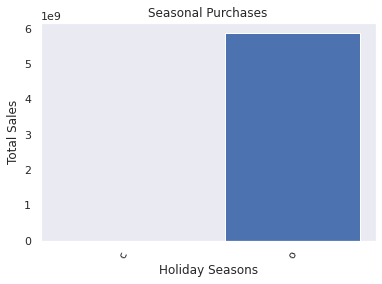

In [ ]:
#bar graph
plt.bar(table.index,table['Sales'])

#xticks 
plt.xticks(rotation=70) 

#x-axis labels 
plt.xlabel('Holiday Seasons') 

#y-axis labels 
plt.ylabel('Total Sales') 

#plot title 
plt.title('Seasonal Purchases') 

4. Correlation between number of customers and Sales

In [ ]:
fig = go.Figure(data=go.Scattergl(
    x = train_data['Sales'],
    y = train_data['Customers'],
    mode='markers',
    marker=dict(
       
        colorscale='Viridis',
        line_width=1
    )
))
fig.update_layout(title='Correlation between number of Customers and Sales',xaxis_title='Customers',
                   yaxis_title='Sales') 
fig.show()

In [ ]:
sales_promo = train_data.groupby('Promo')["Sales"].sum()

In [ ]:
promo_sale= pd.DataFrame({'Promo':sales_promo.index, 'sales_sum':sales_promo.values})

In [ ]:
fig = px.bar(promo_sale, x='Promo', y='sales_sum',
             labels={'pop':'population of Canada'}, height=400)
fig.show()

In [ ]:
customers_promo = train_data.groupby('Promo')["Customers"].sum()

In [ ]:
promo_customers= pd.DataFrame({'Promo':customers_promo.index, 'Customers':customers_promo.values})

In [ ]:
fig = px.bar(promo_customers, x='Promo', y='Customers',
             labels={'pop':'population of Canada'}, height=400)
fig.show()

In [ ]:
# Merge store_df with average store sales & customers
average_sales_customers = train_data.groupby('Store')[["Sales", "Customers"]].mean()
                   
store_df = pd.merge(average_sales_customers, store_data, on='Store',how='inner')

store_df.head()

,Store,Sales,Customers,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,StoreType,Assortment,PromoInterval
0,1,3945.704883,467.646497,1270.0,9.0,2008.0,0,0.0,0.0,2,0,0
1,2,4122.991507,486.045648,570.0,11.0,2007.0,1,13.0,2010.0,0,0,"Jan,Apr,Jul,Oct"
2,3,5741.253715,620.286624,14130.0,12.0,2006.0,1,14.0,2011.0,0,0,"Jan,Apr,Jul,Oct"
3,4,8021.769639,1100.057325,620.0,9.0,2009.0,0,0.0,0.0,2,2,0
4,5,3867.110403,444.360934,29910.0,4.0,2015.0,0,0.0,0.0,0,0,0


In [ ]:
open_data = train_data.groupby(['Open']).agg({'Open': ['count']})
open_data.columns = ['count']
open_data = open_data.reset_index()
print(tabulate(open_data, headers = 'keys', tablefmt = 'fancy_grid'))

╒════╤════════╤═════════╕
│    │   Open │   count │
╞════╪════════╪═════════╡
│  0 │      0 │  172817 │
├────┼────────┼─────────┤
│  1 │      1 │  844338 │
╘════╧════════╧═════════╛


In [ ]:
open_days_data=train_data[train_data['Open']==1]

In [ ]:
open_days_data

,Store,DayOfWeek,Sales,Customers,Open,Promo,SchoolHoliday,Date,StateHoliday,Year,Month
0,1,5,5263,555,1,1,1,2015-07,o,2015,7
1,2,5,6064,625,1,1,1,2015-07,o,2015,7
2,3,5,8314,821,1,1,1,2015-07,o,2015,7
3,4,5,13995,1498,1,1,1,2015-07,o,2015,7
4,5,5,4822,559,1,1,1,2015-07,o,2015,7
...,...,...,...,...,...,...,...,...,...,...,...
1016722,682,2,3375,566,1,0,1,2013-01,a,2013,1
1016773,733,2,10765,2377,1,0,1,2013-01,a,2013,1
1016809,769,2,5035,1248,1,0,1,2013-01,a,2013,1
1016988,948,2,4491,1039,1,0,1,2013-01,a,2013,1


In [ ]:
closed_days_data=train_data[train_data['Open']==0]

In [ ]:
closed_days_data

,Store,DayOfWeek,Sales,Customers,Open,Promo,SchoolHoliday,Date,StateHoliday,Year,Month
291,292,5,0,0,0,1,1,2015-07,o,2015,7
875,876,5,0,0,0,1,1,2015-07,o,2015,7
1406,292,4,0,0,0,1,1,2015-07,o,2015,7
1990,876,4,0,0,0,1,1,2015-07,o,2015,7
2521,292,3,0,0,0,1,1,2015-07,o,2015,7
...,...,...,...,...,...,...,...,...,...,...,...
1017150,1111,2,0,0,0,0,1,2013-01,a,2013,1
1017151,1112,2,0,0,0,0,1,2013-01,a,2013,1
1017152,1113,2,0,0,0,0,1,2013-01,a,2013,1
1017153,1114,2,0,0,0,0,1,2013-01,a,2013,1


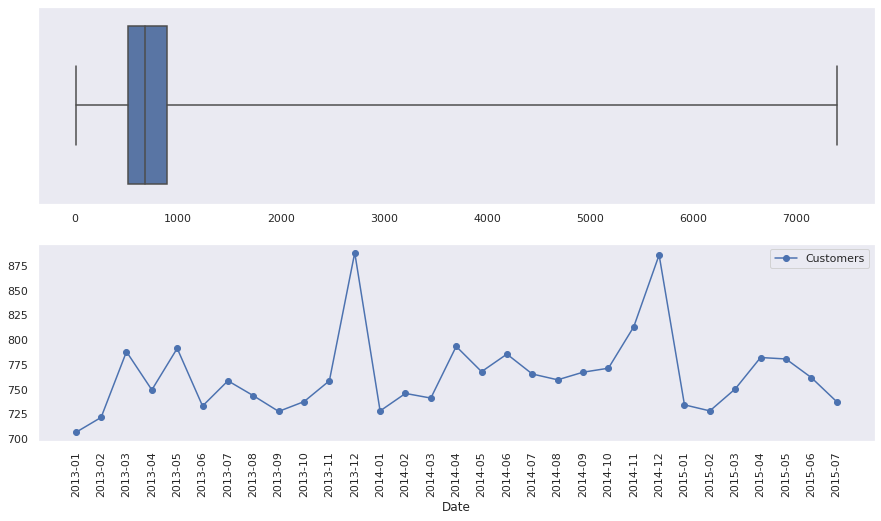

In [ ]:
# Customers

fig, (axis1,axis2) = plt.subplots(2,1,figsize=(15,8))

# Plot max, min values, & 2nd, 3rd quartile
sns.boxplot([open_days_data["Customers"]], whis=np.inf, ax=axis1)

# group by date and get average customers, and precent change
average_customers      = open_days_data.groupby('Date')["Customers"].mean()
# pct_change_customers = rossmann_df.groupby('Date')["Customers"].sum().pct_change()

# Plot average customers over the time
# it should be correlated with the average sales over time
ax = average_customers.plot(legend=True,marker='o', ax=axis2)
ax.set_xticks(range(len(average_customers)))
xlabels = ax.set_xticklabels(average_customers.index.tolist(), rotation=90)

In [ ]:
Average_customers= pd.DataFrame({'Dates':average_customers.index, 'Customers':average_customers.values})

In [ ]:
import plotly.graph_objects as go

# Create random data with numpy
import numpy as np
np.random.seed(1)

'''N = 100
random_x = np.linspace(0, 1, N)
random_y0 = np.random.randn(N) + 5
random_y1 = np.random.randn(N)
random_y2 = np.random.randn(N) - 5'''
x = Average_customers['datetime']
y0 = Average_customers['Customers']
y1 = average_customers_closeddays['Customers']
# Create traces
fig = go.Figure()
fig.add_trace(go.Scatter(x=x, y=y0,
                    mode='lines',
                    name='lines'))
fig.add_trace(go.Scatter(x=x, y=y1,
                    mode='lines+markers',
                    name='lines+markers'))


fig.show()

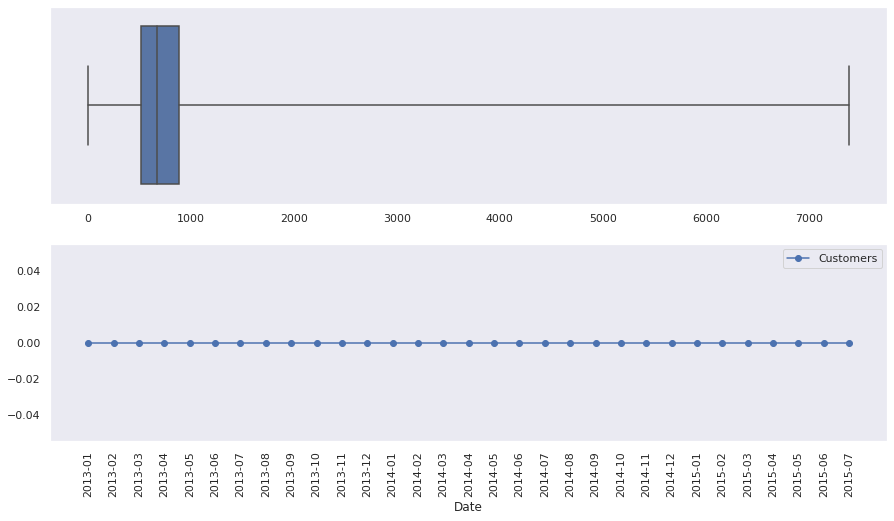

In [ ]:
# Customers

fig, (axis1,axis2) = plt.subplots(2,1,figsize=(15,8))

# Plot max, min values, & 2nd, 3rd quartile
sns.boxplot([open_days_data["Customers"]], whis=np.inf, ax=axis1)

# group by date and get average customers, and precent change
average_customers_closeddays     = closed_days_data.groupby('Date')["Customers"].mean()
# pct_change_customers = rossmann_df.groupby('Date')["Customers"].sum().pct_change()

# Plot average customers over the time
# it should be correlated with the average sales over time
ax = average_customers_closeddays.plot(legend=True,marker='o', ax=axis2)
ax.set_xticks(range(len(average_customers)))
xlabels = ax.set_xticklabels(average_customers_closeddays.index.tolist(), rotation=90)

In [ ]:
weekly_data = train_data.groupby(['DayOfWeek']).agg({'DayOfWeek': ['count']})
weekly_data.columns = ['count']
weekly_data = weekly_data.reset_index()
print(tabulate(weekly_data, headers = 'keys', tablefmt = 'fancy_grid'))

╒════╤═════════════╤═════════╕
│    │   DayOfWeek │   count │
╞════╪═════════════╪═════════╡
│  0 │           1 │  144727 │
├────┼─────────────┼─────────┤
│  1 │           2 │  145658 │
├────┼─────────────┼─────────┤
│  2 │           3 │  145651 │
├────┼─────────────┼─────────┤
│  3 │           4 │  145827 │
├────┼─────────────┼─────────┤
│  4 │           5 │  145838 │
├────┼─────────────┼─────────┤
│  5 │           6 │  144724 │
├────┼─────────────┼─────────┤
│  6 │           7 │  144730 │
╘════╧═════════════╧═════════╛


In [ ]:
weekdays_data=train_store_data[train_data['DayOfWeek']<6]
weekend_data=train_store_data[train_data['DayOfWeek']>=6]

In [ ]:
weekdays_data

,Store,DayOfWeek,Sales,Customers,Open,Promo,SchoolHoliday,Date,StateHoliday,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,StoreType,Assortment,PromoInterval,Year,Month,Day,SalePerCustomer
0,1,5,5263,555,1,1,1,2015-07-31,o,1270.0,9.0,2008.0,0,0.0,0.0,2,0,0,2015,7,31,9.482883
1,1,4,5020,546,1,1,1,2015-07-30,o,1270.0,9.0,2008.0,0,0.0,0.0,2,0,0,2015,7,30,9.194139
2,1,3,4782,523,1,1,1,2015-07-29,o,1270.0,9.0,2008.0,0,0.0,0.0,2,0,0,2015,7,29,9.143403
3,1,2,5011,560,1,1,1,2015-07-28,o,1270.0,9.0,2008.0,0,0.0,0.0,2,0,0,2015,7,28,8.948214
4,1,1,6102,612,1,1,1,2015-07-27,o,1270.0,9.0,2008.0,0,0.0,0.0,2,0,0,2015,7,27,9.970588
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1017150,1115,6,4771,339,1,0,1,2013-01-05,o,5350.0,0.0,0.0,1,22.0,2012.0,3,2,"Mar,Jun,Sept,Dec",2013,1,5,14.073746
1017151,1115,5,4540,326,1,0,1,2013-01-04,o,5350.0,0.0,0.0,1,22.0,2012.0,3,2,"Mar,Jun,Sept,Dec",2013,1,4,13.926380
1017152,1115,4,4297,300,1,0,1,2013-01-03,o,5350.0,0.0,0.0,1,22.0,2012.0,3,2,"Mar,Jun,Sept,Dec",2013,1,3,14.323333
1017153,1115,3,3697,305,1,0,1,2013-01-02,o,5350.0,0.0,0.0,1,22.0,2012.0,3,2,"Mar,Jun,Sept,Dec",2013,1,2,12.121311


In [ ]:
weekend_data

**StoreType**

In this section we will closely look at different levels of StoreType and how the main metric Sales is distributed among them.

In [ ]:
train_store_data.groupby('StoreType')['Sales'].describe()

,count,mean,std,min,25%,50%,75%,max
StoreType,,,,,,,,
0,551592.0,5738.543813,3963.890348,0.0,3508.0,5618.0,7860.0,41551.0
1,15827.0,10060.743982,5279.209395,0.0,6228.0,9028.0,13083.5,38722.0
2,136830.0,5724.047548,3721.515199,0.0,3789.0,5766.5,7849.0,31448.0
3,312906.0,5641.927425,3473.339220,0.0,3986.0,5826.0,7691.0,38037.0


StoreType B has the highest average of Sales among all others, however we have much less data for it. So let's print an overall sum of Sales and Customers to see which StoreType is the most selling and crowded one:



In [ ]:
train_store_data.groupby('StoreType')['Customers', 'Sales'].sum()

,Customers,Sales
StoreType,,
0,363541431,3165334859
1,31465616,159231395
2,92129705,783221426
3,156904995,1765392943


Clearly stores of type A. StoreType D goes on the second place in both Sales and Customers. What about date periods? 

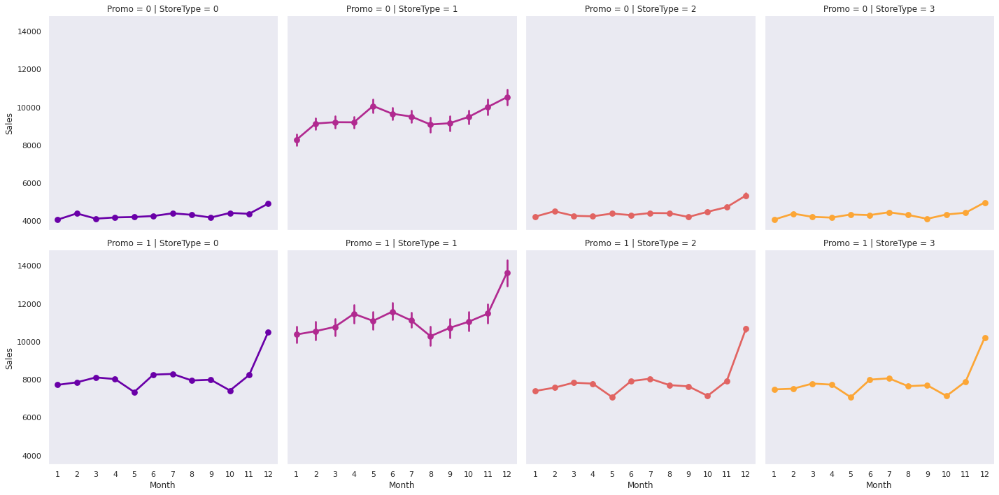

In [ ]:
# sales trends
sns.factorplot(data = train_store_data, x = 'Month', y = "Sales", 
               col = 'StoreType', # per store type in cols
               palette = 'plasma',
               hue = 'StoreType',
               row = 'Promo', # per promo in the store in rows
               color = 'green') 

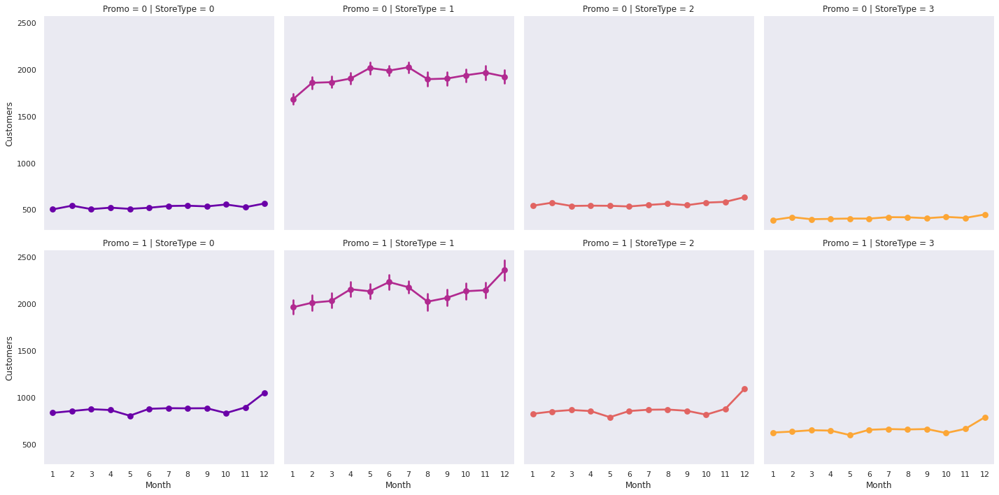

In [ ]:
# Customers trends
sns.factorplot(data = train_store_data, x = 'Month', y = "Customers", 
               col = 'StoreType', # per store type in cols
               palette = 'plasma',
               hue = 'StoreType',
               row = 'Promo', # per promo in the store in rows
               color = 'black') 

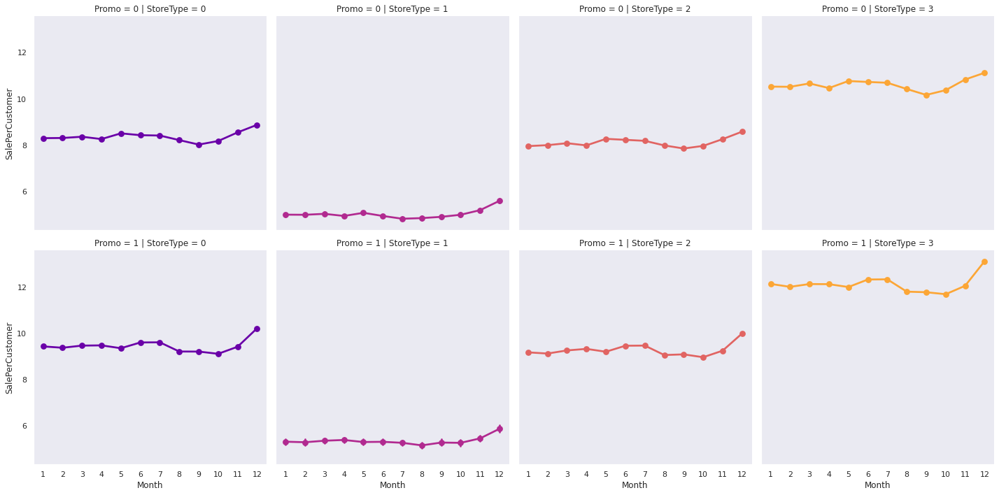

In [ ]:
# sale per customer trends
sns.factorplot(data = train_store_data, x = 'Month', y = "SalePerCustomer", 
               col = 'StoreType', # per store type in cols
               palette = 'plasma',
               hue = 'StoreType',
               row = 'Promo', # per promo in the store in rows
               color = 'black') 

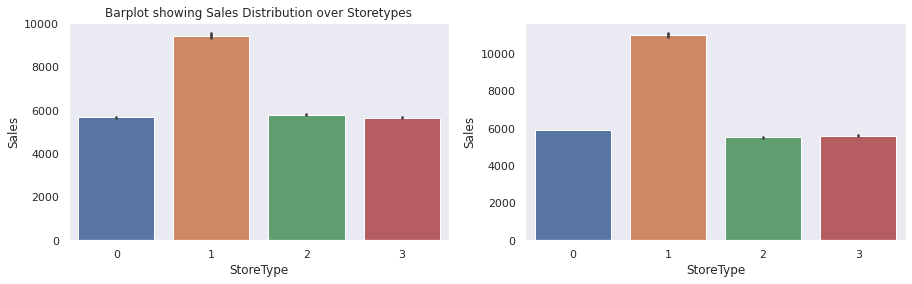

In [ ]:
fig, (axis1,axis2) = plt.subplots(1,2,figsize=(15,4))

sns.barplot(x='StoreType', y='Sales', data=weekdays_data,ax=axis1).set(title='Barplot showing Sales Distribution over Storetypes')
sns.barplot(x='StoreType', y='Sales', data=weekend_data, ax=axis2)

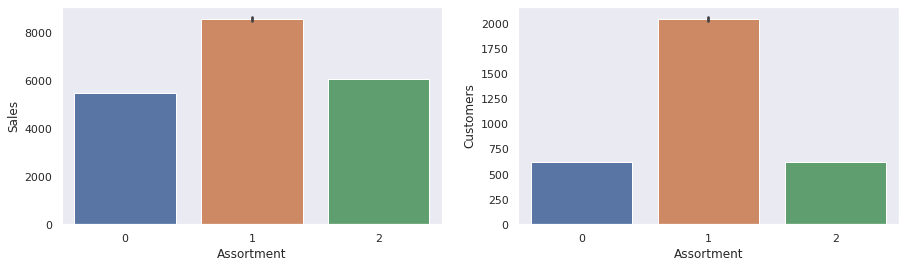

In [ ]:
fig, (axis1,axis2) = plt.subplots(1,2,figsize=(15,4))

sns.barplot(x='Assortment', y='Sales', data=train_store_data, ax=axis1)
sns.barplot(x='Assortment', y='Customers', data=train_store_data,  ax=axis2)

In [ ]:
x=train_store_data['CompetitionDistance']
y=train_store_data['Sales']
fig = px.scatter(x=x, y=y)
fig.update_layout(title='SCatterPlot for Competitor Distance and sales',xaxis_title='Cometitor Distance in metres',
                   yaxis_title='Sales') 
fig.show()

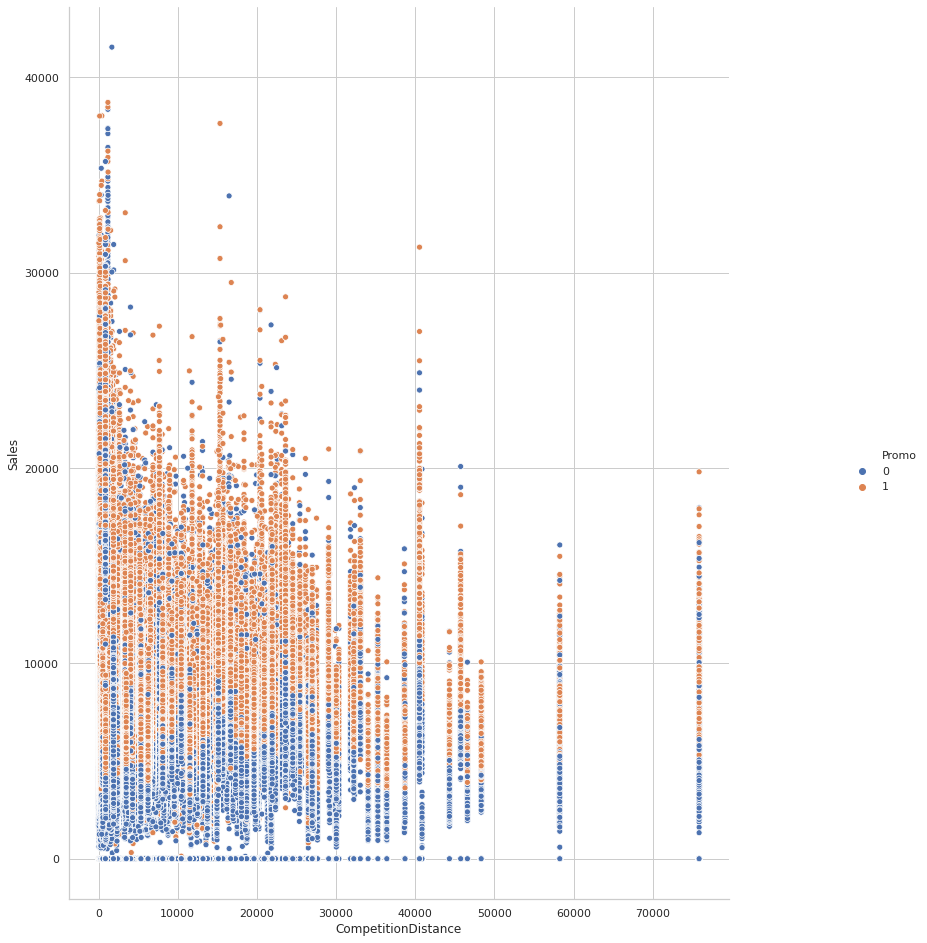

In [ ]:
sns.set(style="whitegrid")
g=sns.relplot(x="CompetitionDistance", y="Sales", hue="Promo", data=train_store_data)
g.fig.set_size_inches(15,15)

In [ ]:
fig = go.Figure(data=go.Scattergl(
    x=train_store_data['CompetitionDistance'],
    y=train_store_data['Sales'],
    mode='markers',
    marker=dict(
        
        colorscale='Viridis',
        line_width=1
    )
  
))
fig.update_layout(title='SCatterPlot for Competitor Distance and sales',xaxis_title='Cometitor Distance in metres',
                   yaxis_title='Sales') 
fig.show()

In [ ]:
train_store_data.head()

,Store,DayOfWeek,Sales,Customers,Open,Promo,SchoolHoliday,Date,StateHoliday,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,StoreType,Assortment,PromoInterval,Year,Month,Day,SalePerCustomer
0,1,5,5263,555,1,1,1,2015-07-31,o,1270.0,9.0,2008.0,0,0.0,0.0,2,0,0,2015,7,31,9.482883
1,1,4,5020,546,1,1,1,2015-07-30,o,1270.0,9.0,2008.0,0,0.0,0.0,2,0,0,2015,7,30,9.194139
2,1,3,4782,523,1,1,1,2015-07-29,o,1270.0,9.0,2008.0,0,0.0,0.0,2,0,0,2015,7,29,9.143403
3,1,2,5011,560,1,1,1,2015-07-28,o,1270.0,9.0,2008.0,0,0.0,0.0,2,0,0,2015,7,28,8.948214
4,1,1,6102,612,1,1,1,2015-07-27,o,1270.0,9.0,2008.0,0,0.0,0.0,2,0,0,2015,7,27,9.970588


In [ ]:
top_5_stores=train_store_data.sort_values(by='Sales',ascending=False).head(5)

In [ ]:
top_5_stores

,Store,DayOfWeek,Sales,Customers,Open,Promo,SchoolHoliday,Date,StateHoliday,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,StoreType,Assortment,PromoInterval,Year,Month,Day,SalePerCustomer
827550,909,1,41551,1721,1,0,0,2015-06-22,o,1680.0,0.0,0.0,1,45.0,2009.0,0,2,"Feb,May,Aug,Nov",2015,6,22,24.143521
237505,262,5,38722,5132,1,1,0,2015-04-03,b,1180.0,5.0,2013.0,0,0.0,0.0,1,0,0,2015,4,3,7.545207
237477,262,5,38484,5458,1,1,0,2015-05-01,a,1180.0,5.0,2013.0,0,0.0,0.0,1,0,0,2015,5,1,7.050934
237464,262,4,38367,5192,1,0,1,2015-05-14,a,1180.0,5.0,2013.0,0,0.0,0.0,1,0,0,2015,5,14,7.389638
51500,57,1,38037,1970,1,1,0,2014-06-16,o,420.0,6.0,2014.0,0,0.0,0.0,3,2,0,2014,6,16,19.308122


**Correlation Analysis**

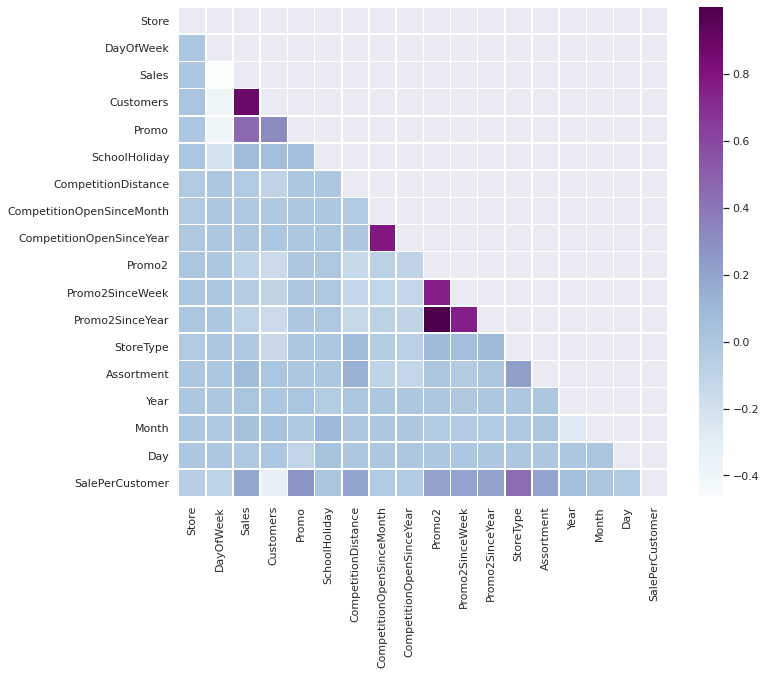

In [ ]:
# Compute the correlation matrix 
# exclude 'Open' variable
corr_all = train_store_data.drop('Open', axis = 1).corr()

# Generate a mask for the upper triangle
mask = np.zeros_like(corr_all, dtype = np.bool)
mask[np.triu_indices_from(mask)] = True

# Set up the matplotlib figure
f, ax = plt.subplots(figsize = (11, 9))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr_all, mask = mask,
            square = True, linewidths = .5, ax = ax, cmap = "BuPu")      
plt.show()

As mentioned before, we have a strong positive correlation between the amount of Sales and Customers of a store. We can also observe a positive correlation between the fact that the store had a running promotion (Promo equal to 1) and amount of Customers.

However, as soon as the store continues a consecutive promotion (Promo2 equal to 1) the number of Customers and Sales seems to stay the same or even decrease, which is described by the pale negative correlation on the heatmap. The same negative correlation is observed between the presence of the promotion in the store and the day of a week.